## play music of data


////////////////  TODO  ////////////////

- Make it do batches
- find proper metric for logging errors (accuracy of notes)
- create specialist
- gen_music(model), generate music from model
- how to decide binary key-press? sample with probability og pressing X(beeing avg. heys pressed at any time?)
    - https://github.com/calclavia/DeepJ/blob/icsc/generate.py 
    - apply_temperature from code above makes it more likely to dont press buttons when there has been a pause


In [1]:
import sys
sys.path.append("helpers/")

#Libraries
import pandas as pd
import numpy as np
import pickle
import torch
import torch.nn as nn
import torch.nn.functional as F

print "torchversion: ", torch.__version__

#Custom libraries
import dataset
import datapreparation

#PATHS
DATASET_PATH = 'datasets/training/'
FS1 = 'piano_roll_fs1/'
FS2 = 'piano_roll_fs2/'
FS5 = 'piano_roll_fs5/'
FULL_PATH = DATASET_PATH + FS5


%load_ext autoreload
%autoreload 2

torchversion:  0.4.1


# Inspect the dataset

In [2]:

#LOAD
dataset_names = datapreparation.load_all_dataset_names(FULL_PATH)
print(dataset_names)
datasets = datapreparation.load_all_dataset(FULL_PATH)
#datasets_df = pd.DataFrame(datasets)

#CONSTANTS
max_length = datapreparation.get_max_length(datasets)
num_keys = datapreparation.get_numkeys(datasets)[0]
print("max_length: ", max_length)
print("num_keys: ", num_keys)

['bach', 'bach', 'bach', 'brahms', 'brahms', 'brahms', 'brahms', 'brahms', 'brahms', 'brahms', 'brahms', 'brahms', 'brahms', 'debussy', 'debussy', 'debussy', 'debussy', 'debussy', 'debussy', 'debussy', 'debussy', 'debussy', 'mz', 'mz', 'mz', 'mz', 'mz', 'mz', 'mz', 'mz', 'mz', 'mz', 'mz', 'mz', 'mz', 'mz', 'mz', 'mz', 'mz', 'mz', 'mz', 'mz', 'mz']
('max_length: ', 4154)
('num_keys: ', 128)


# Split datasets

In [3]:
# shuffles the dataset on creation
Dataset = dataset.pianoroll_dataset_batch(FULL_PATH)
# splits the datasets
training_data, validation_data, testing_data = Dataset.split_datasets(split=[0.7,0.85, 1.0])


Number of songs in training_data: 30
Number of songs in validation_data: 7
Number of songs in testing_data: 6


# Sample from dataset

Bach


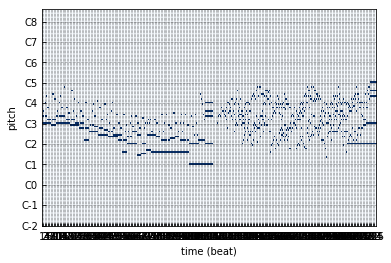

In [4]:
#VISUALIZE
print('Bach')
datapreparation.visualize_piano_roll(datasets[0])

datapreparation.embed_play_v1(datasets[0])



In [ ]:
from matplotlib import pyplot as plt
#train_loss = pickle.load(open( 'saved_losses/model_test1_0.pickle', "rb" ))
def plot_loss(metrics):
    
    train_loss = metrics[0]
    test_loss = metrics[1]
    train_acc = metrics[2]
    test_acc = metrics[3]
    
    #df=pd.DataFrame({'x': range(1,11), 'y1': np.random.randn(10), 'y2': np.random.randn(10)+range(1,11), 'y3': np.random.randn(10)+range(11,21) })
    # flatten trainloss
    plot_df = pd.DataFrame(metrics)
    #display(plot_df.values)
    plt.plot(plot_df)
    plt.show()

----
# Generalist composer
The aim is to train a neural network that can create music in general. It shall be kickstarted by real music. Meaning that it will get some seconds of real music and then it wil continue playing music.

In [ ]:
# TRAIN GENERALIST

# set parameters for the model
input_size = num_keys
hidden_size = 64
num_tags = len(pd.unique(dataset_names))
num_layers = 1
generalist = Generalist(input_size, hidden_size, num_layers)

# set parameters for the training process
name = "generalist_test1"
epochs = 200
batch_size = 4 # does not effect training. need to implement in def train
lr = 1e-1
criterion = nn.MSELoss() # it will create default criterion
optimizer = None # it will create default optimizer

trained_generalist, gen_train_loss, gen_val_loss, gen_train_acc, gen_test_acc  = train_batch(generalist, training_data, validation_data, name, criterion, epochs, lr, optimizer, batch_size)


Epoch: 0
Training Loss: 0.249071
Train Accuracy: 0.020572
Validation Loss: 0.062327
Valid Accuracy: 0.715238
New best at epoch 0...
New best at epoch 1...
Epoch: 10
Training Loss: 0.020638
Train Accuracy: 0.971828
Validation Loss: 0.020217
Valid Accuracy: 0.973666
Epoch: 20
Training Loss: 0.020638
Train Accuracy: 0.971957
Validation Loss: 0.020217
Valid Accuracy: 0.974009


In [ ]:
# load loss
loaded_generalist_loss = pickle.load(open( 'saved_losses/generalist_test1_200.pickle', "rb" ))
plot_loss(loaded_generalist_loss)

----
# Specialist composer
The aim is to train a neural network that can create music similar to a specific composer. It shall be kickstarted by a song from that composer. Meaning that it will get some seconds of the song and then it should be able to compose music that is typically similar to that specific composer

----
# Models (to be deleted)

In [6]:
# model
class Generalist(nn.Module):
    def __init__(self, input_size, hidden_size, num_layers):
        super(Generalist, self).__init__()
        self.input_size = input_size
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        
        self.notes_encoder = nn.Linear(in_features=input_size,
                                       out_features=hidden_size)
        self.gru = nn.GRU(hidden_size, hidden_size, num_layers)
        self.notes_decoder = nn.Linear(in_features=hidden_size,
                                      out_features=input_size)
        self.sigmoid = nn.Sigmoid()
        
    def forward(self, input_sequence, tag, hidden=None):
        
        enc_notes = self.notes_encoder(input_sequence)
        """
        # Run rnns on non-padded regions of the batch
        packed_seq = torch.nn.utils.rnn.pack_padded_sequence(notes_encoded, input_seq_lengths)
        outputs, hidden = self.GRU(packed_seq, hidden)
        outputs, output_lengths = torch.nn.utils.rnn.pad_packed_sequence(outputs) # back to padded format
        """

        outputs, hidden = self.gru(enc_notes, hidden)
        
        outputs = self.sigmoid(self.notes_decoder(outputs))
        return outputs, hidden


class Specialist(nn.Module):
    def __init__(self, input_size, hidden_size, num_tags, num_layers):
        super(Specialist, self).__init__()
        self.input_size = input_size
        self.hidden_size = hidden_size
        self.num_tags = num_tags
        self.num_layers = num_layers
        
        self.tags_embedding = nn.Embedding(num_tags, hidden_size)
        self.notes_encoder = nn.Linear(in_features=input_size,
                                       out_features=hidden_size)
        self.gru = nn.GRU(hidden_size, hidden_size, num_layers)
        self.notes_decoder = nn.Linear(in_features=hidden_size,
                                      out_features=input_size)
        self.sigmoid = nn.Sigmoid()
        
    def forward(self, input_sequence, tag, hidden=None):
        if (hidden is None):
            hidden = self.tags_embedding(tag)
            hidden = torch.cat(tuple((hidden for i in range(self.num_layers))))
            enc_input = self.notes_encoder(input_sequence)
        
        
        output, hidden = self.gru(self.notes_encoder(input_sequence), hidden)
        output = self.sigmoid(self.notes_decoder(output))
        return output, hidden


In [ ]:

def train_batch(model, training_data, validation_data, name="test1", criterion=None, epochs=3, lr=1e-2, optimizer=None, batch_size=None):
    if criterion is None:
        criterion = nn.BCELoss()
    if optimizer is None:
        optimizer = torch.optim.Adam(model.parameters(), lr=lr)
    best_val_loss = float("inf")
    train_loss_epochs = []
    val_loss_epochs = []
    train_accuracy_epochs = []
    test_accuracy_epochs = []
    
    for epoch in range(epochs):
        loss_songs = []
        val_loss_songs = []
        train_total_correct_keys = 0
        test_total_correct_keys = 0
        train_total_keys = 0
        test_total_keys = 0
        
        # TRAINING
        for song, tag, target in training_data:
            hidden = None   #Must be done inside model-object with batchs
            model.zero_grad()
            
            prob_sounds, hidden = model.forward(song, tag=tag, hidden=hidden)
            
            
            # tracking loss
            loss = criterion(prob_sounds, target)
            loss_songs.append(loss.item())
            loss.backward(retain_graph=True)
            
            # predict keypress by only taking those over 0.5 of highest
            rounded_pred = torch.round(prob_sounds/torch.max(prob_sounds))
            correct_keys = ((rounded_pred == target).sum()).item()
            nr_of_keys = len(song) * 128 
            train_total_correct_keys += correct_keys   
            train_total_keys += nr_of_keys
        
        #optimize after one song
        #torch.nn.utils.clip_grad_norm(model.parameters(), 1.0)
        optimizer.step()
        
        train_loss_epochs.append(np.mean(loss_songs))
        train_accuracy_epochs.append(train_total_correct_keys / float(train_total_keys))
        
        # VALIDATION
        for song, tag, target in validation_data:
            hidden = None
            
            prob_sounds, hidden = model.forward(song, tag=tag, hidden=hidden)
            
            loss = criterion(prob_sounds, target)
            val_loss_songs.append(loss.item())
            
            # predict keypress by only taking those over 0.5 of highest
            rounded_pred = torch.round(prob_sounds/torch.max(prob_sounds))
            correct_keys = ((rounded_pred == target).sum()).item()
            nr_of_keys = len(song) * 128 
            test_total_correct_keys += correct_keys   
            test_total_keys += nr_of_keys
                
        val_loss_epochs.append(np.mean(val_loss_songs))
        test_accuracy_epochs.append(test_total_correct_keys / float(test_total_keys))
        
        if epoch % 10== 0:
            print('Epoch: {}'.format(epoch))
            print('Training Loss: {:.6f}'.format(train_loss_epochs[-1]))
            print('Train Accuracy: {:.6f}'.format(train_accuracy_epochs[-1]))
            print('Validation Loss: {:.6f}'.format(val_loss_epochs[-1]))
            print('Valid Accuracy: {:.6f}'.format(test_accuracy_epochs[-1]))
            
        if np.sum(val_loss_epochs[-1]) < best_val_loss:
            print('New best at epoch {}...'.format(epoch))
            torch.save(model.state_dict(), 'saved_models/'+name+'_'+str(epoch)+'.pth')
            best_val_loss = val_loss_epochs[-1]
            pickle.dump([train_loss_epochs, val_loss_epochs, train_accuracy_epochs, test_accuracy_epochs], open( 'saved_losses/'+name+'_'+str(epoch)+'.pickle', "wb" ) )
    
    print "Done training, saving last model and losses"
    torch.save(model.state_dict(), 'saved_models/'+name+'_'+str(epoch)+'.pth')
    pickle.dump([train_loss_epochs, val_loss_epochs, train_accuracy_epochs, test_accuracy_epochs], open( 'saved_losses/'+name+'_'+str(epoch)+'.pickle', "wb" ) )
    
    return model, train_loss_epochs, val_loss_epochs, train_accuracy_epochs, test_accuracy_epochs
            

In [ ]:
# TRAIN GENERALIST

# set parameters for the model
input_size = num_keys
hidden_size = 64
num_tags = len(pd.unique(dataset_names))
num_layers = 1
generalist = Generalist(input_size, hidden_size, num_layers)

# set parameters for the training process
name = "generalist_test1"
epochs = 200
batch_size = 4 # does not effect training. need to implement in def train
lr = 1e-1
criterion = nn.MSELoss() # it will create default criterion
optimizer = None # it will create default optimizer

trained_generalist, gen_train_loss, gen_val_loss, gen_acc  = train_batch(generalist, training_data, validation_data, name, criterion, epochs, lr, optimizer, batch_size)


In [ ]:
# TRAIN

#load
#training_data = dataset.pianoroll_dataset_batch(FULL_PATH)

#params
#parameters
input_size = num_keys
hidden_size = 64
num_tags = len(pd.unique(dataset_names))
num_layers = 1
model = Specialist(input_size, hidden_size, num_tags, num_layers)

trained_model, train_loss = train(model, training_data, criterion=None, lr=1e-1, batch_size=None, epochs=5)

print training_data.num_keys()
print training_data.num_tags()
print training_data.__len__()
print training_data.gen_batch()
element = training_data[30]
print(element[2].shape)



In [ ]:
from matplotlib import pyplot as plt
#train_loss = pickle.load(open( 'saved_losses/model_test1_0.pickle', "rb" ))
def plot_loss(train_loss):
    
    # flatten trainloss
    plot_df = pd.DataFrame(train_loss[0])
    #display(plot_df.values)
    plt.plot(plot_df)
    plt.show()

In [ ]:

plot_loss(train_loss)  
    

In [ ]:
# GENERATE MUSIC FROM MODEL

def gen_music(song, model, p=0.5):
    """p: float 0<1 beeing the percentage of timesteps in the song it gets before continuing"""
    print "Composer: ", num_to_composer(song[1].item())
    hidden = None
    
    real_song = song[0]
    print real_song.shape
    
    #fake_song = torch.zeros(1, song[0].shape[1], song[0].shape[2])
    #fake_song.new_empty(real_song.shape)
    fake_song_list = []
    #print fake_song
    
    real_song_length = song[0].shape[0]-1
    nr_given_notes = int(np.floor(real_song_length*p))
    #print real_song_length
    print "nr given notes: ", nr_given_notes

    for i in range(song[0].shape[0]):
        if i < nr_given_notes:
            last_sound = song[0][None, i]
        else:
            last_sound = guessed_sound
            
        guessed_sound, hidden = model.forward(last_sound, tag=song[1], hidden=hidden)
        #print(guessed_sound.shape)
        fake_song_list.append(last_sound)
    
    fake_song = torch.cat(fake_song_list)
    fake_song = fake_song.squeeze().t().detach().numpy()
    real_song = np.array(real_song.squeeze().t())
    print "REAL-shape: ", real_song.shape
    print "FAKE-shape: ", fake_song.shape
    
    #vizually compare notes
    datapreparation.visualize_piano_roll(real_song) # modify to have red line on p
    datapreparation.visualize_piano_roll(fake_song) # modify to have red line on p
    
    # sound quality check
    display(datapreparation.embed_play_v1(real_song))
    display(datapreparation.embed_play_v1(fake_song))
    return fake_song
    
    
def num_to_composer(num):
    composer_names = {
        0:'bach',
        1:'brahms',
        2:'debussy',
        3:'mz'
    }
    return composer_names[num]
    
    

    
# pick song
song = training_data[9]
# load best model
model = Specialist(input_size, hidden_size, num_tags, num_layers)
model.load_state_dict(torch.load('saved_models/model_test1_2.pth'))
# percent of song played for model
fake_song = gen_music(song, model, 0.4)



In [ ]:
# pick song
song = training_data[0]
# load best model
model = Generalist(input_size, hidden_size, num_layers)
model.load_state_dict(torch.load('saved_models/generalist_test1_47.pth'))

In [ ]:
datapreparation.gen_music_seconds(model,init=song[0],composer=song[1],fs=5,gen_seconds=20,init_seconds=10)